<a href="https://colab.research.google.com/github/selengetu/EDA-Movie/blob/main/ps4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Problem Set 4

by Shakleen Ishfar and Selenge Tulga

In [3]:
import numpy as np
from numpy import linalg as lg
import pandas as pd
from sklearn.manifold import SpectralEmbedding
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from sklearn.manifold import TSNE
from scipy import interpolate
from scipy.spatial import ConvexHull

## 2

### a.

1. Separate X from y
2. Subtract mean to have zero mean in all features.
3. Standardize if interested in central tendency: $P$
4. Calculate Variance-covariance matrix: $P^T \times P$
5. Eigen decomposition: Transform $P^T \times P$ to $ZDZ^{-1}$
6. Sort columns of Z by eigen value from largest to smallest: $Z*$
7. Calculate $P*=PZ*$
8. Decide on how many columns to keep.

In [4]:
def pca(
    X: np.ndarray,
    k: int = 2,
    standardize: bool = True,
):
    P = X - np.mean(X, axis=0, keepdims=True)

    if standardize:
        P = MinMaxScaler().fit_transform(P)

    V = np.cov(P, rowvar=False)
    D, Z = lg.eig(V)

    Z_star = Z[np.argsort(D)[::-1]]

    P_star = np.matmul(P, Z_star)

    return P_star[:, :k]


pca(np.random.rand(3, 4))

array([[-0.14221441,  0.99635404],
       [-0.59414398,  0.22241971],
       [ 0.02374249, -0.04111102]])

### b.

In [5]:
data = pd.read_excel("moral_machine_data.xlsx")
data.shape

(1483, 148)

In [6]:
df = data.loc[:, "man_no_of_passengers_died":]
out = pca(df.to_numpy())
out

array([[ 0.05848829,  0.1061185 ],
       [ 0.05423772, -0.01028542],
       [ 0.08193379, -0.0978752 ],
       ...,
       [ 0.205059  ,  0.0206304 ],
       [-0.22003011,  0.09981055],
       [ 0.15707095,  0.03238353]])

In [7]:
data["pca_dim_1"] = out[:, 0]
data["pca_dim_2"] = out[:, 1]

In [8]:
data.to_csv("df.csv", index=False)

## 3

In [9]:
def plot(column):
    mpl.rcParams["figure.dpi"] = 200
    plt.rcParams["figure.figsize"] = (20.0, 10.0)
    plt.rcParams["font.family"] = "serif"
    plt.rcParams["font.size"] = 4

    df["kmeans_label"] = pd.Categorical(df[column]).codes
    pal = sns.color_palette("Paired")[: len(set(df["kmeans_label"]))]
    p1 = sns.scatterplot(
        x="pca_dim_1",
        y="pca_dim_2",
        hue="kmeans_label",
        palette=pal,
        data=df,
        s=250,
        alpha=0.7,
        legend=False,
    )

    # For each point, we add a text inside the bubble
    for line in range(0, df.shape[0]):
        p1.text(
            df.pca_dim_1[line],
            df.pca_dim_2[line],
            df[column][line],
            horizontalalignment="left",
            size="medium",
            color="black",
            weight="semibold",
        )

    plt.suptitle(f"Two-Dimensional Map of {column} (PCA)", fontsize=36)
    plt.xlabel("PCA - Dimension 1", fontsize=24)
    plt.ylabel("PCA - Dimension 2", fontsize=24)

    from scipy import interpolate
    from scipy.spatial import ConvexHull

    for i in df.kmeans_label.unique():
        # get the convex hull
        points = df[df.kmeans_label == i][["pca_dim_1", "pca_dim_2"]].values
        hull = ConvexHull(points)
        x_hull = np.append(points[hull.vertices, 0], points[hull.vertices, 0][0])
        y_hull = np.append(points[hull.vertices, 1], points[hull.vertices, 1][0])

        # interpolate
        dist = np.sqrt(
            (x_hull[:-1] - x_hull[1:]) ** 2 + (y_hull[:-1] - y_hull[1:]) ** 2
        )
        dist_along = np.concatenate(([0], dist.cumsum()))
        spline, u = interpolate.splprep([x_hull, y_hull], u=dist_along, s=0)
        interp_d = np.linspace(dist_along[0], dist_along[-1], 50)
        interp_x, interp_y = interpolate.splev(interp_d, spline)
        # plot shape
        plt.fill(interp_x, interp_y, "--", c=pal[i], alpha=0.2)

    plt.grid()
    plt.show()

In [10]:
df = pd.read_csv("df.csv")

### a

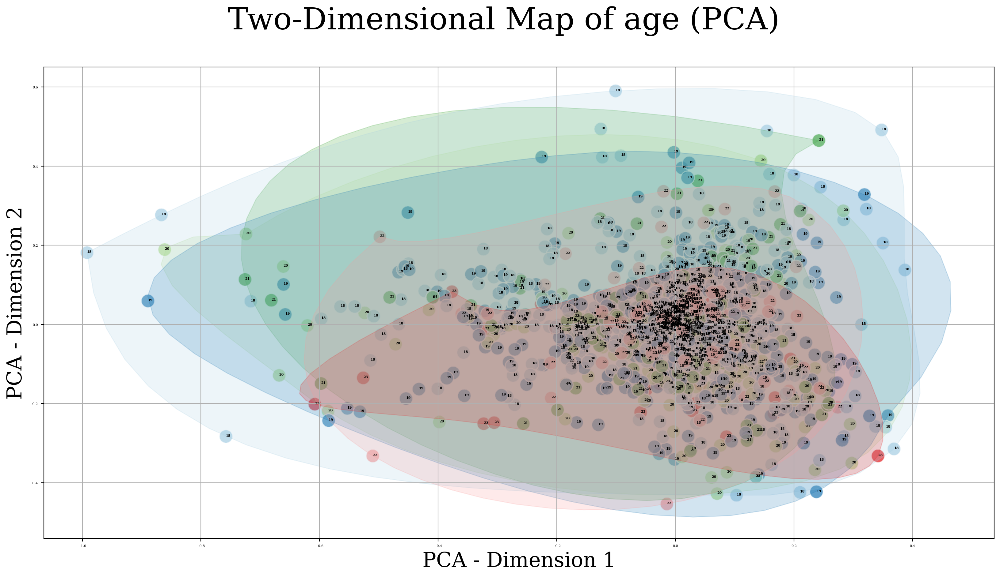

In [11]:
plot("age")

### b

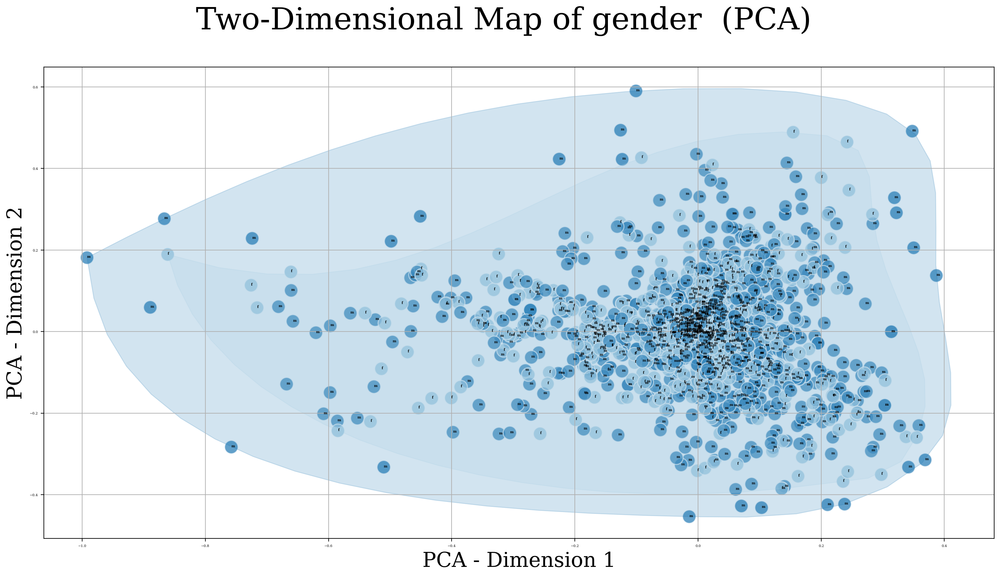

In [12]:
plot("gender ")

### c

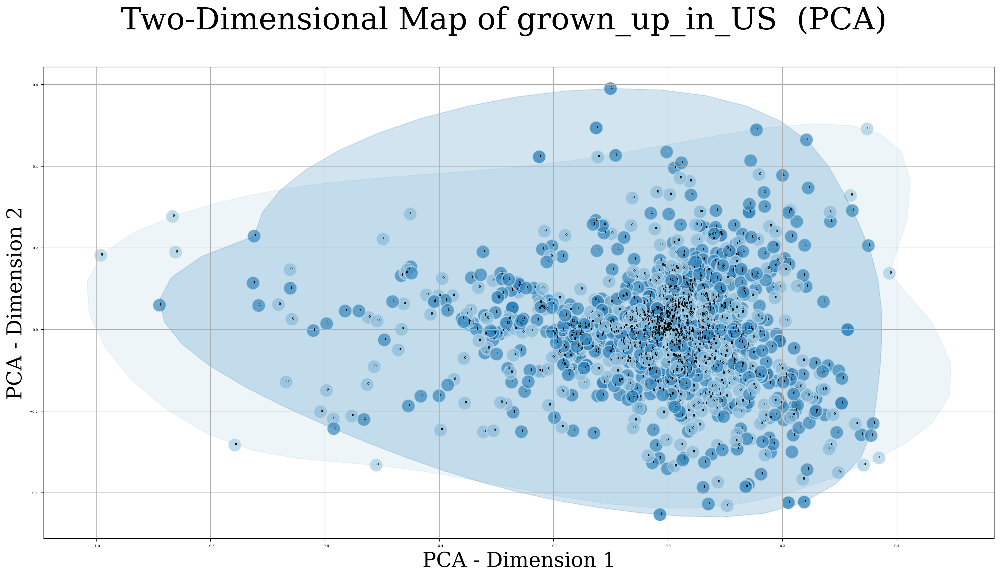

In [13]:
plot("grown_up_in_US ")

### d

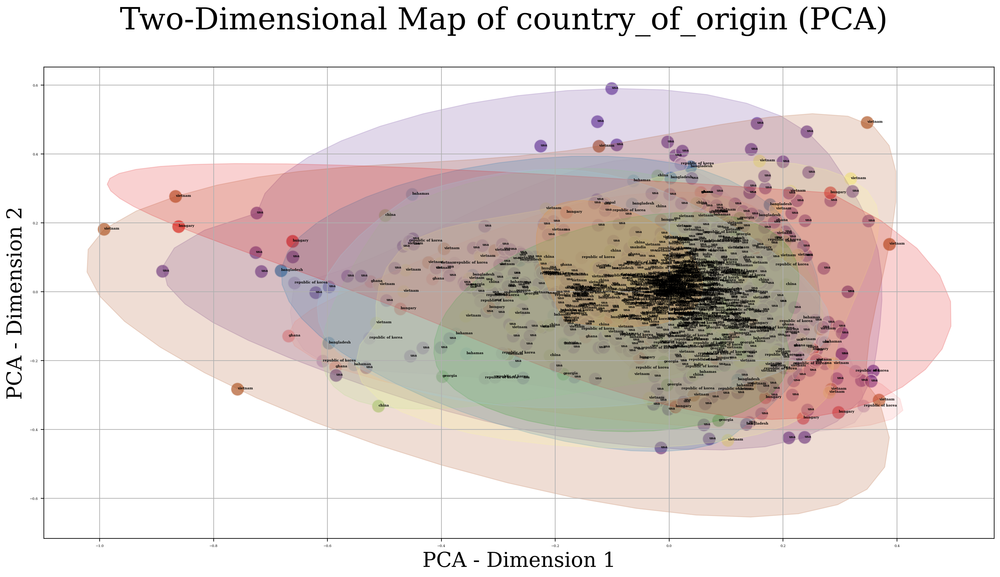

In [14]:
plot("country_of_origin")

### e

In [15]:
df["no_of_siblings"] = df["no_of_sisters"].astype(int) + df["no_of_brothers"].astype(int)

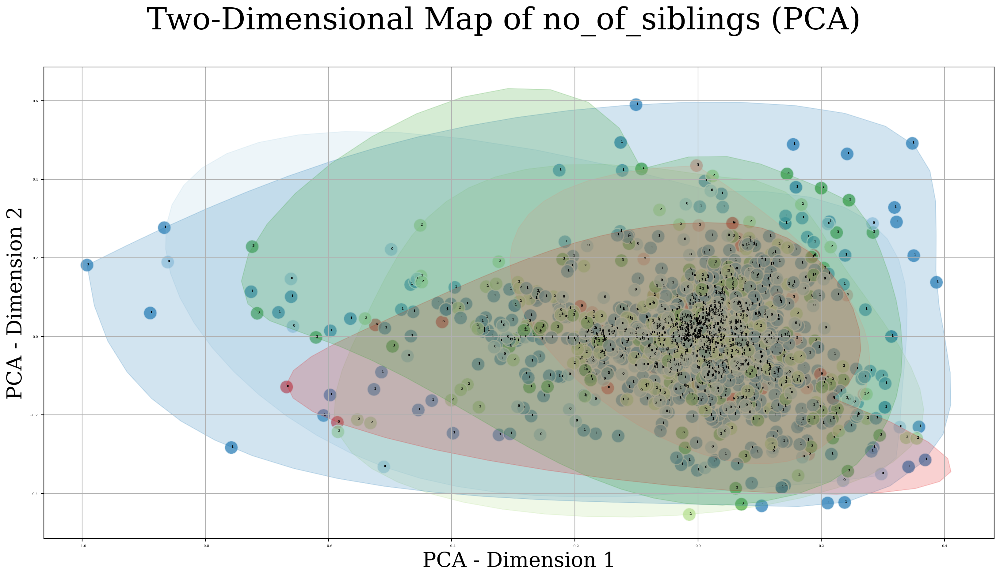

In [16]:
plot("no_of_siblings")

4

In [17]:
# Apply Spectral Embedding for dimensionality reduction
embedding = SpectralEmbedding(n_components=2, random_state=265)
selected_columns = data.loc[:, "man_no_of_passengers_died":].to_numpy()  # Adjust if necessary
X_transformed = embedding.fit_transform(selected_columns)

# Update your DataFrame with the new dimensions
data["se_dim_1"] = X_transformed[:, 0]
data["se_dim_2"] = X_transformed[:, 1]

def plot(column):
    mpl.rcParams["figure.dpi"] = 200
    plt.rcParams["figure.figsize"] = (20.0, 10.0)
    plt.rcParams["font.family"] = "serif"
    plt.rcParams["font.size"] = 4

    # Categorize data based on the specified column for color coding in the plot
    data["kmeans_label"] = pd.Categorical(data[column]).codes
    pal = sns.color_palette("Paired")[:len(set(data["kmeans_label"]))]

    # Create scatter plot
    p1 = sns.scatterplot(
        x="se_dim_1",
        y="se_dim_2",
        hue="kmeans_label",
        palette=pal,
        data=data,
        s=250,
        alpha=0.7,
        legend=False,
    )

    # For each point, add text inside the bubble
    for line in range(0, data.shape[0]):
        p1.text(
            data.se_dim_1[line],
            data.se_dim_2[line],
            data[column][line],
            horizontalalignment="left",
            size="medium",
            color="black",
            weight="semibold",
        )

    # Drawing Convex Hull
    for i in data.kmeans_label.unique():
        points = data[data.kmeans_label == i][["se_dim_1", "se_dim_2"]].values
        if points.shape[0] > 2:  # ConvexHull needs at least 3 points
            hull = ConvexHull(points)
            x_hull = np.append(points[hull.vertices, 0], points[hull.vertices, 0][0])
            y_hull = np.append(points[hull.vertices, 1], points[hull.vertices, 1][0])
            dist = np.sqrt((x_hull[:-1] - x_hull[1:])**2 + (y_hull[:-1] - y_hull[1:])**2)
            dist_along = np.concatenate(([0], dist.cumsum()))
            spline, u = interpolate.splprep([x_hull, y_hull], u=dist_along, s=0)
            interp_d = np.linspace(dist_along[0], dist_along[-1], 50)
            interp_x, interp_y = interpolate.splev(interp_d, spline)
            plt.fill(interp_x, interp_y, "--", c=pal[i], alpha=0.2)

    plt.title(f"Visualization of {column} with Spectral Embedding", fontsize=16)
    plt.xlabel("Spectral Embedding Dimension 1")
    plt.ylabel("Spectral Embedding Dimension 2")
    plt.grid(True)
    plt.show()

a.

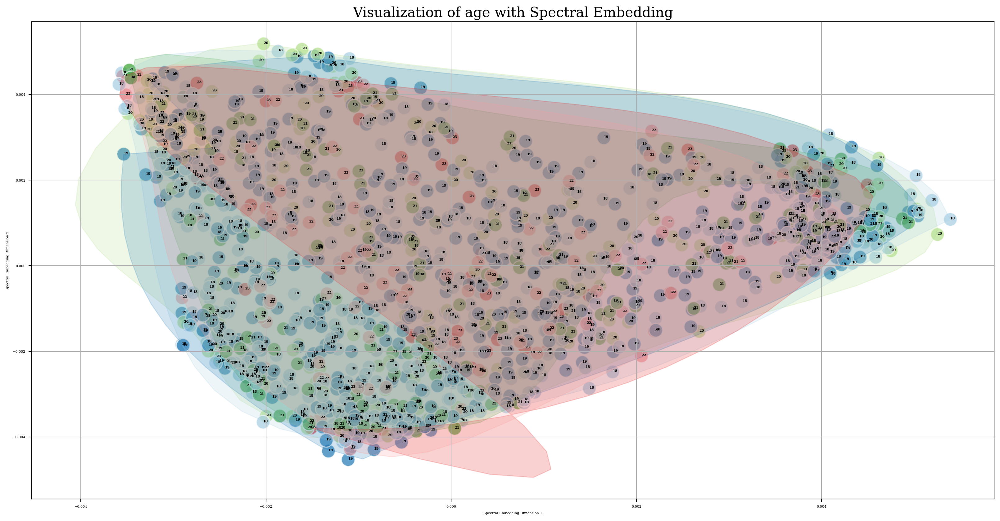

In [18]:
plot("age")

b.

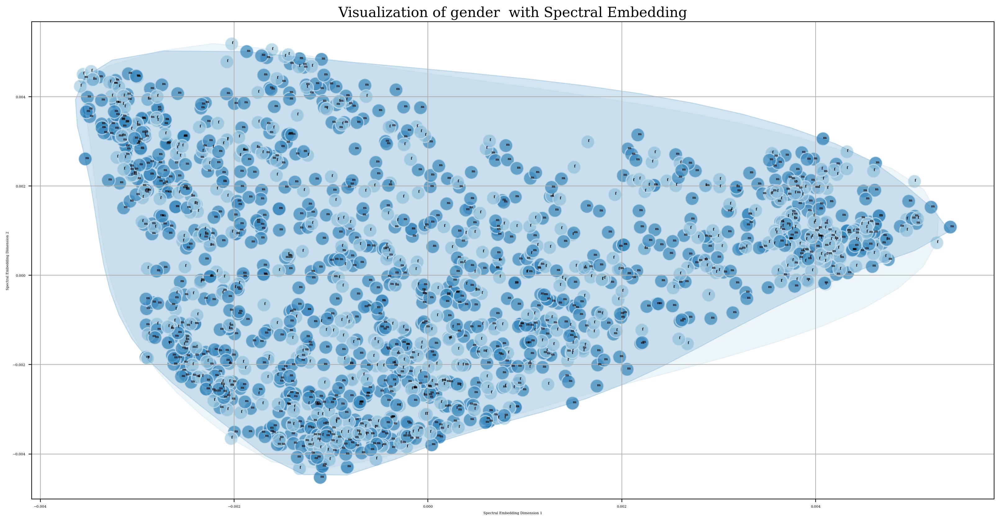

In [19]:
plot("gender ")

c.

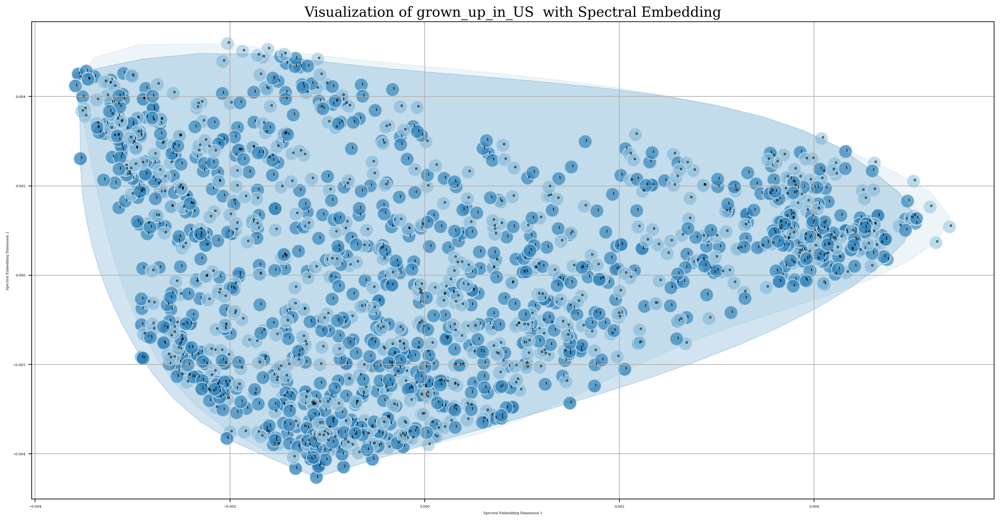

In [20]:
plot("grown_up_in_US ")

d.

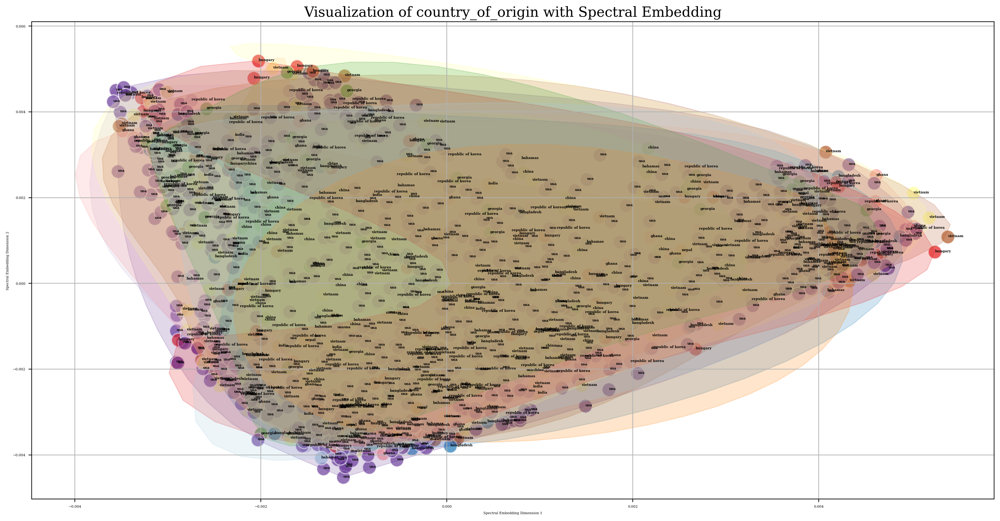

In [21]:
plot("country_of_origin")

e.

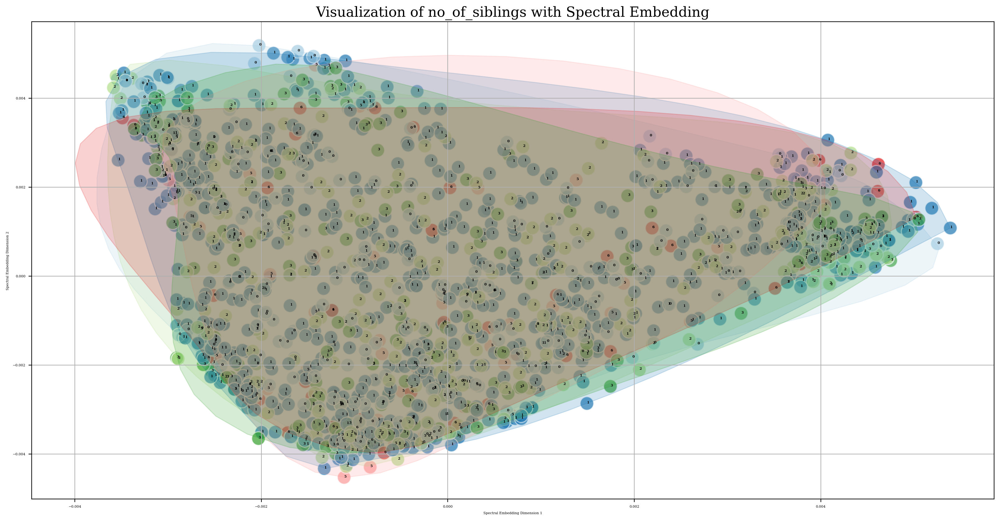

In [22]:
data["no_of_siblings"] = data["no_of_sisters"].astype(int) + data["no_of_brothers"].astype(int)
plot("no_of_siblings")

5.

In [23]:
# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=3)  # Using sklearn's default perplexity
selected_columns = data.loc[:, "man_no_of_passengers_died":].to_numpy()  # Adjust if necessary
X_transformed = tsne.fit_transform(selected_columns)

# Update your DataFrame with the new dimensions
data["tsne_dim_1"] = X_transformed[:, 0]
data["tsne_dim_2"] = X_transformed[:, 1]

def plot(column):
    mpl.rcParams["figure.dpi"] = 200
    plt.rcParams["figure.figsize"] = (20.0, 10.0)
    plt.rcParams["font.family"] = "serif"
    plt.rcParams["font.size"] = 4

    # Categorize data based on the specified column for color coding in the plot
    data["kmeans_label"] = pd.Categorical(data[column]).codes
    pal = sns.color_palette("Paired")[:len(set(data["kmeans_label"]))]

    # Create scatter plot
    p1 = sns.scatterplot(
        x="tsne_dim_1",
        y="tsne_dim_2",
        hue="kmeans_label",
        palette=pal,
        data=data,
        s=250,
        alpha=0.7,
        legend=False,
    )

    # For each point, add text inside the bubble
    for line in range(0, data.shape[0]):
        p1.text(
            data.tsne_dim_1[line],
            data.tsne_dim_2[line],
            data[column][line],
            horizontalalignment="left",
            size="medium",
            color="black",
            weight="semibold",
        )

    # Drawing Convex Hull
    for i in data.kmeans_label.unique():
        points = data[data.kmeans_label == i][["tsne_dim_1", "tsne_dim_2"]].values
        if points.shape[0] > 2:  # ConvexHull needs at least 3 points
            hull = ConvexHull(points)
            x_hull = np.append(points[hull.vertices, 0], points[hull.vertices, 0][0])
            y_hull = np.append(points[hull.vertices, 1], points[hull.vertices, 1][0])
            dist = np.sqrt((x_hull[:-1] - x_hull[1:])**2 + (y_hull[:-1] - y_hull[1:])**2)
            dist_along = np.concatenate(([0], dist.cumsum()))
            spline, u = interpolate.splprep([x_hull, y_hull], u=dist_along, s=0)
            interp_d = np.linspace(dist_along[0], dist_along[-1], 50)
            interp_x, interp_y = interpolate.splev(interp_d, spline)
            plt.fill(interp_x, interp_y, "--", c=pal[i], alpha=0.2)

    plt.title(f"Visualization of {column} with t-SNE", fontsize=16)
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.grid(True)
    plt.show()

a.

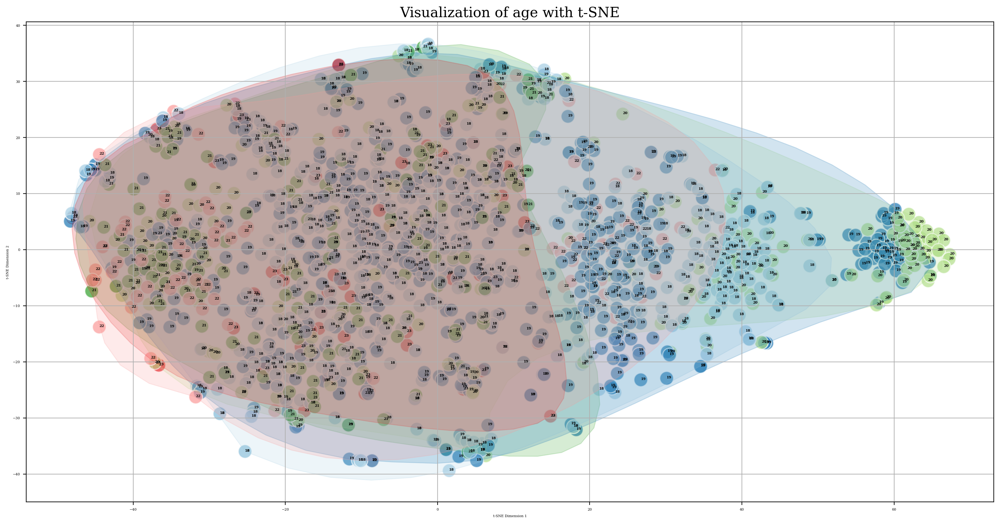

In [24]:
plot("age")

b.

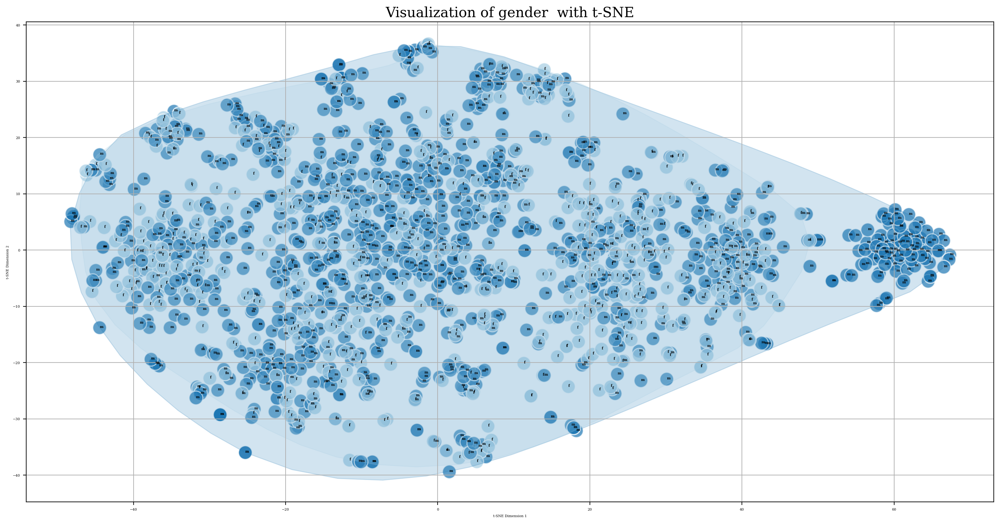

In [25]:
plot("gender ")

c.

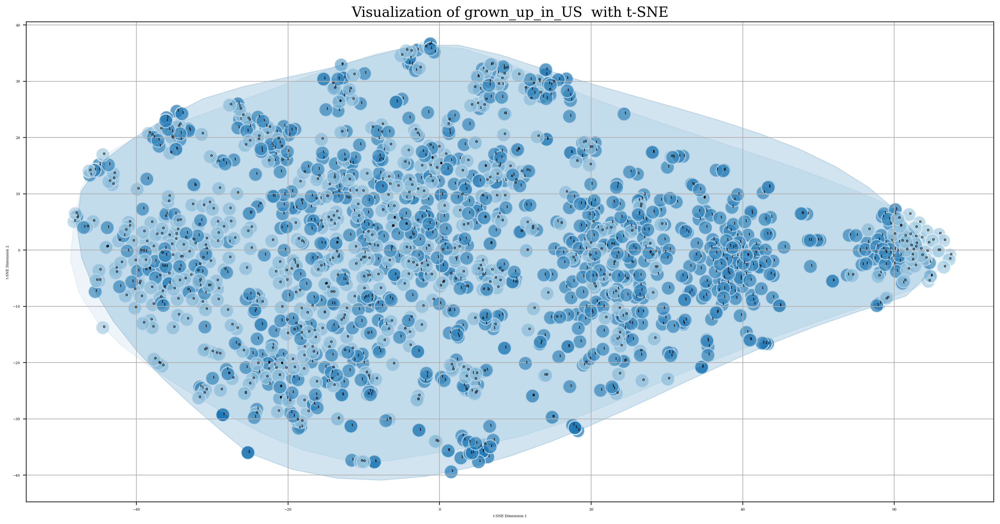

In [26]:
plot("grown_up_in_US ")

d.

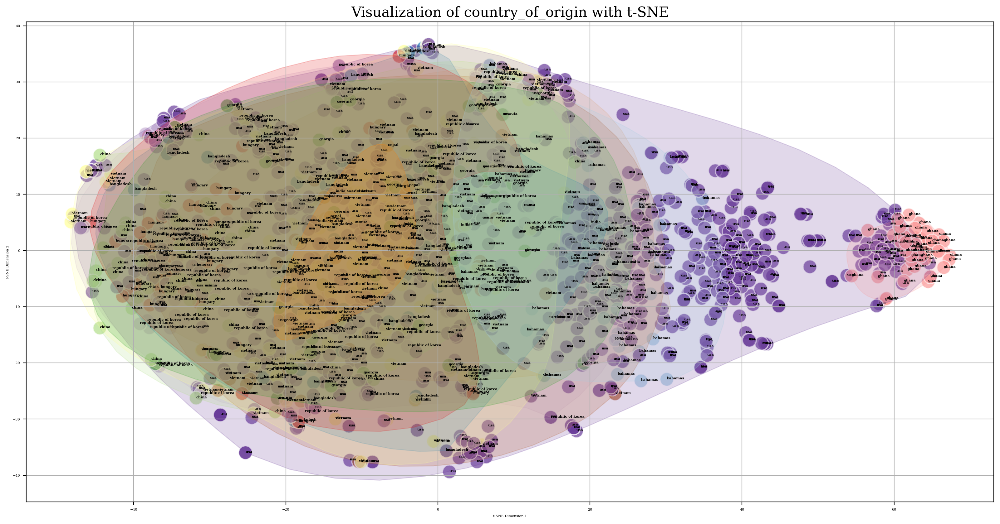

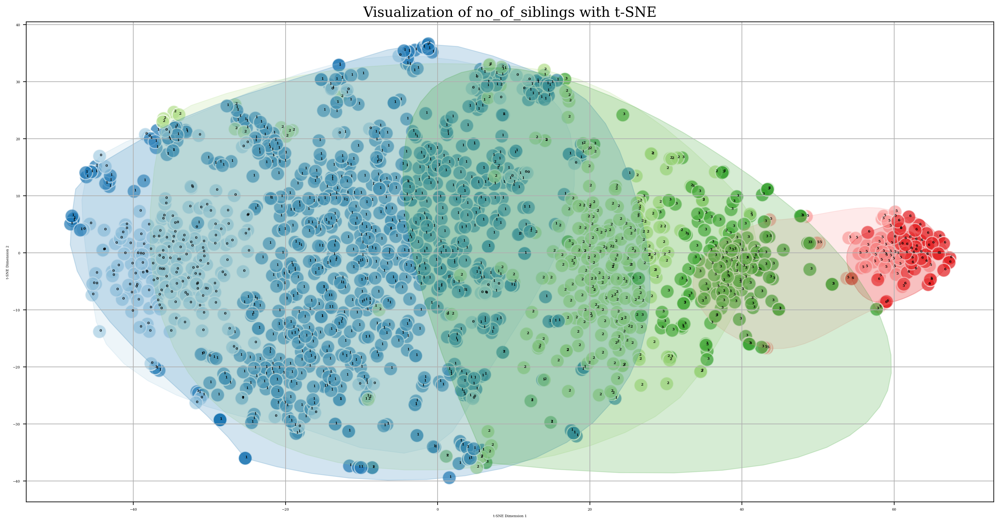

In [27]:
plot("country_of_origin")


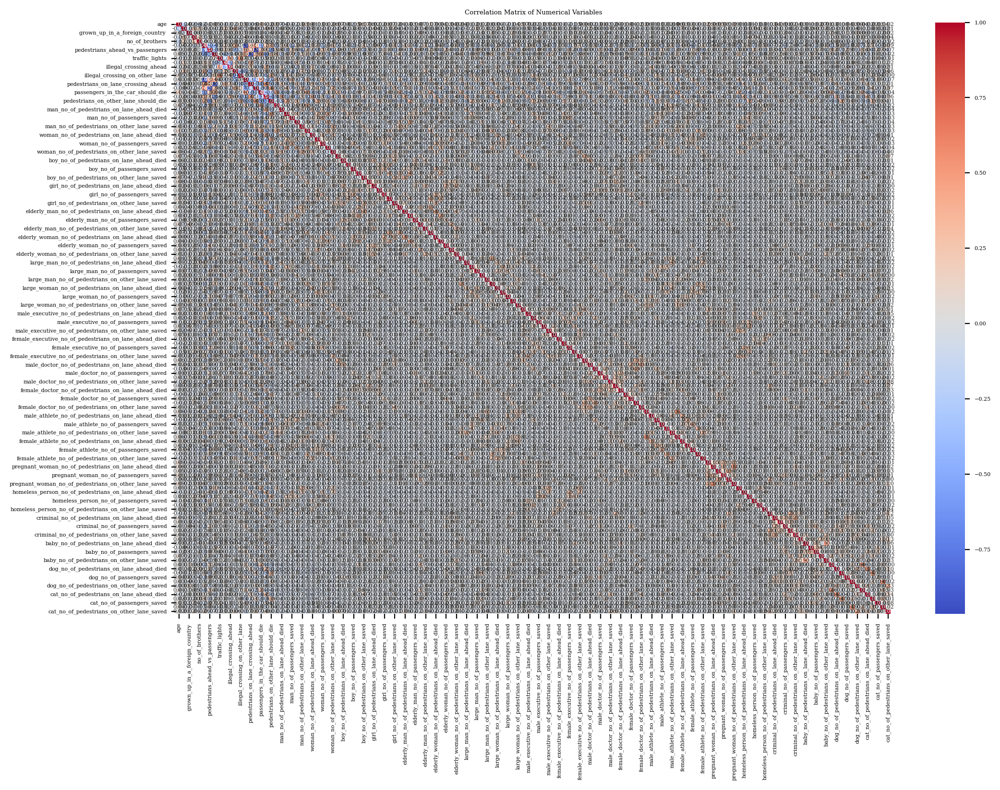

In [28]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset
data = pd.read_excel("moral_machine_data.xlsx")

# Select only numerical and numerically coded variables
# This excludes string (object type) variables
numerical_data = data.select_dtypes(include=['int64', 'float64', 'int32', 'float32'])

# Calculate the correlation matrix
correlation_matrix = numerical_data.corr()

# Visualize the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title('Correlation Matrix of Numerical Variables')
plt.show()
